In [1]:
%load_ext autoreload
%autoreload 2
import sys
import os

if not getattr(sys, "_src_path_added", False):
    src_path = os.path.abspath(os.path.join(os.getcwd(), ".."))
    if src_path not in sys.path:
        sys.path.insert(0, src_path)
    sys._src_path_added = True 

In [2]:
from MTGA.MTGA import *

from MTGA.MTGAInstance import Instance
import MTGA.Generators as Generators
import MTGA.Mutators as Mutators
import MTGA.WeightGenerators as WeightGenerators
import MTGA.GeneMutators as GeneMutators
import Fixers as Fixers
import Evaluators as Evaluators

from MTGA.GeneVisualizer import GeneEvolutionRenderer
from Displayer import Displayer

from Utils import *
from MTGA.MTGAUtils import *

## Main Instance

In [3]:
instance = Instance("../problems/p3.json",
    evaluator=Evaluators.CummulativeEvaluator(),
    mutator=Mutators.WalkMutator(),
    generator=Generators.TruncatedNormal(),
    fixer=Fixers.ChoiceFixer(),
    weight_generator=WeightGenerators.SoftmaxWeights(),
    gene_mutator=GeneMutators.Normal())

problem size 100
fire starts [1]
num teams 18


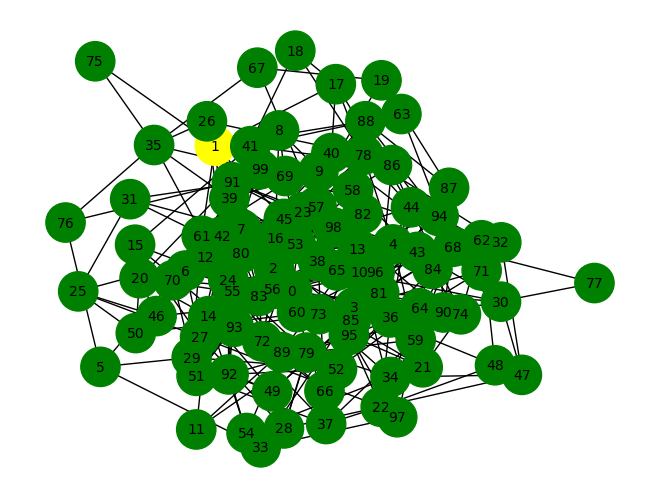

In [4]:
print("problem size", instance.size)
print("fire starts", instance.problem.fire_starts)
print("num teams", instance.problem.num_teams)
draw_graph(instance.problem)

In [5]:
displayer = Displayer()
gene_displayer = GeneEvolutionRenderer()

## The Run

In [6]:
data = optimize_and_collect(instance)

[2025-02-09 18:23:09][  0]     0.15571761     0.15562010 {135.00000000 166.40000000 290.00000000  27.24187952}
[2025-02-09 18:23:09][  1]     0.27885461     0.12107801 {137.00000000 166.54200000 348.00000000  28.69843612}
[2025-02-09 18:23:09][  2]     0.43259501     0.15030742 {136.00000000 168.92600000 467.00000000  35.03187868}
[2025-02-09 18:23:09][  3]     0.56453872     0.12601542 {139.00000000 167.50800000 351.00000000  29.03442674}
[2025-02-09 18:23:10][  4]     0.71772122     0.14777303 {137.00000000 167.93600000 413.00000000  30.39341876}
[2025-02-09 18:23:10][  5]     0.88867950     0.16833305 {140.00000000 168.18800000 353.00000000  30.41783451}
[2025-02-09 18:23:10][  6]     1.02475810     0.13204098 {139.00000000 166.30200000 378.00000000  29.83626646}
[2025-02-09 18:23:10][  7]     1.15721869     0.13073945 {138.00000000 166.98200000 371.00000000  29.69278828}
[2025-02-09 18:23:10][  8]     1.27155232     0.11296606 {138.00000000 166.35600000 340.00000000  27.73375676}
[

In [7]:
solutions = correct_solutions(instance)

## Results

In [8]:
best_solution, best_solutions_value = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value}]:\n{best_solution}")

Best solution [3]:
[3, 6, 11, 18, 22, 30, 51, 55, 57, 62, 64, 67, 68, 75, 83, 86, 90, 93]


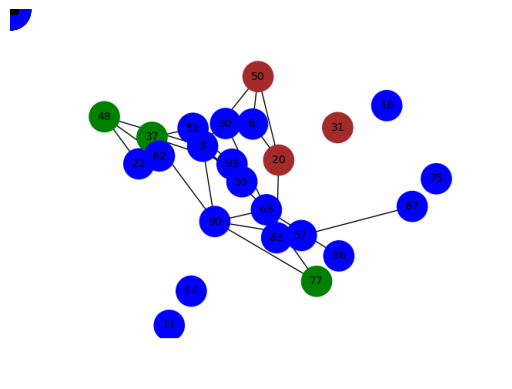

In [9]:
instance.problem.visualize_fire_without_burned(displayer, best_solution)

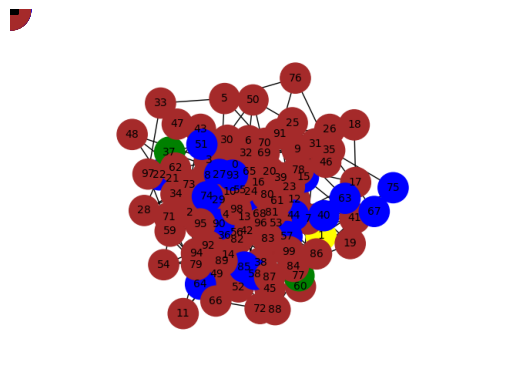

In [10]:
instance.problem.visualize_fires(displayer, solutions)

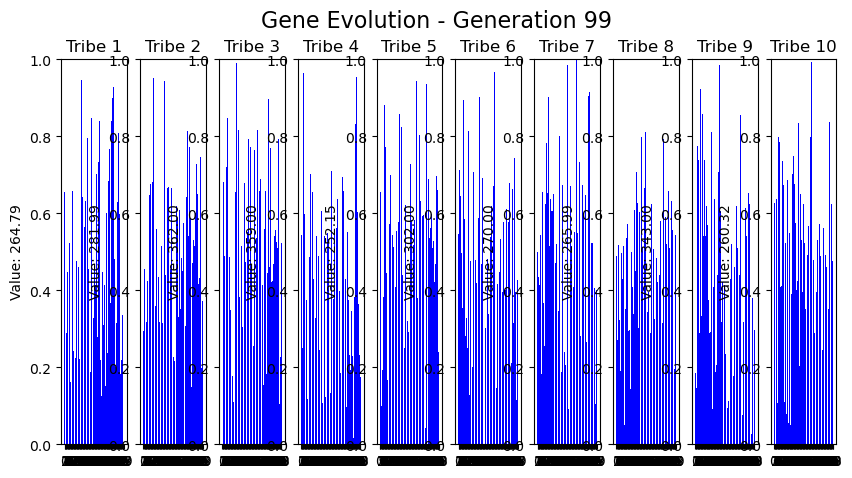

In [11]:
gene_displayer.visualize(data)

## Instance 200

data collected


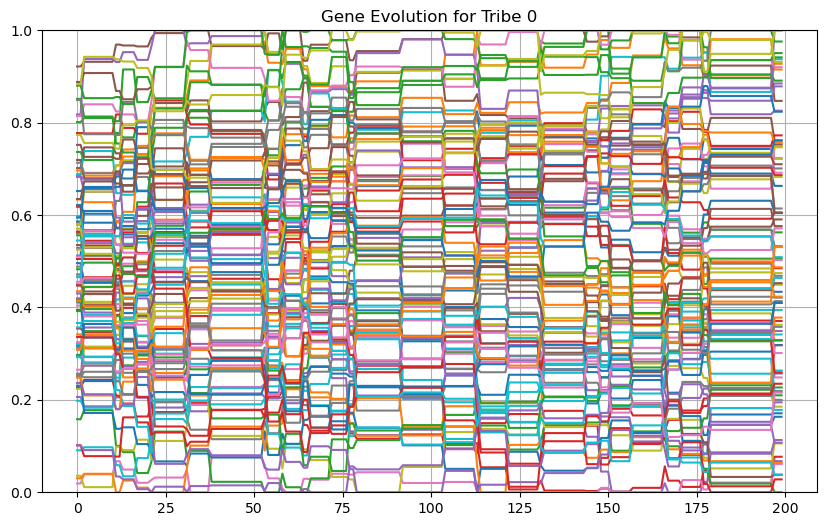

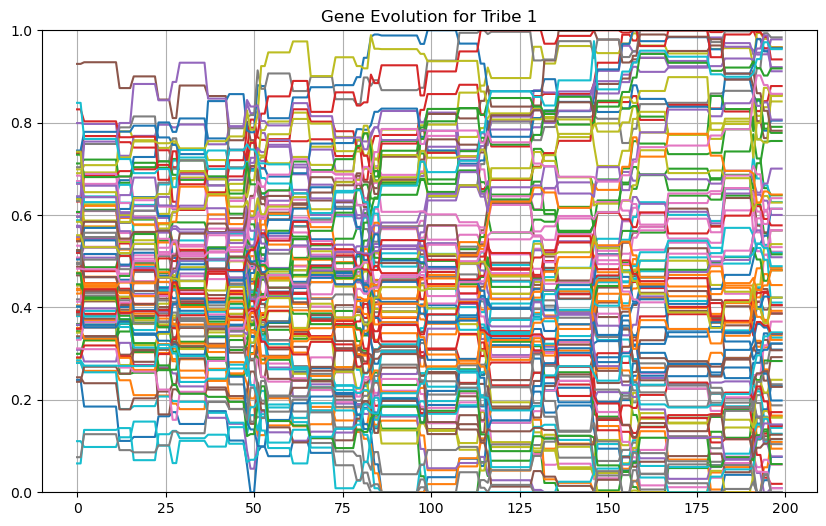

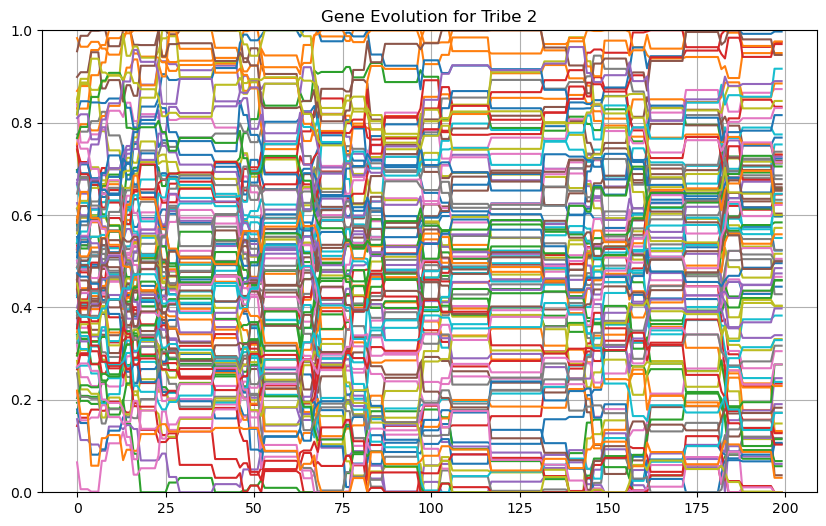

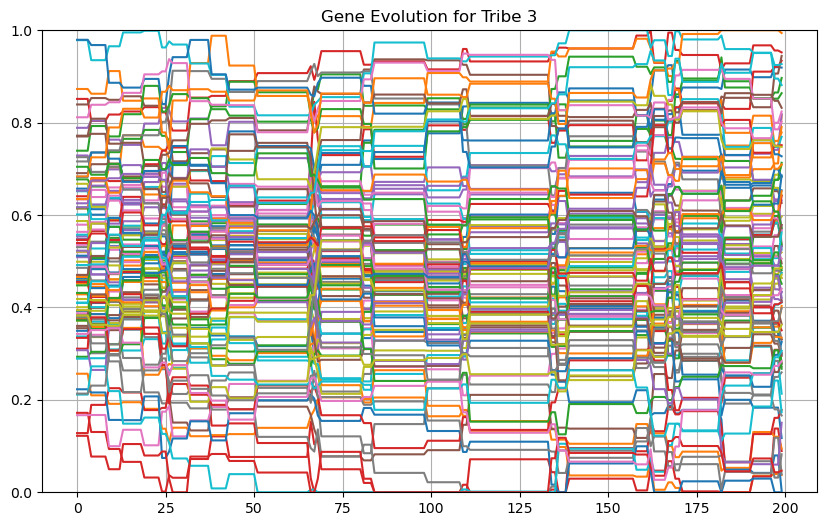

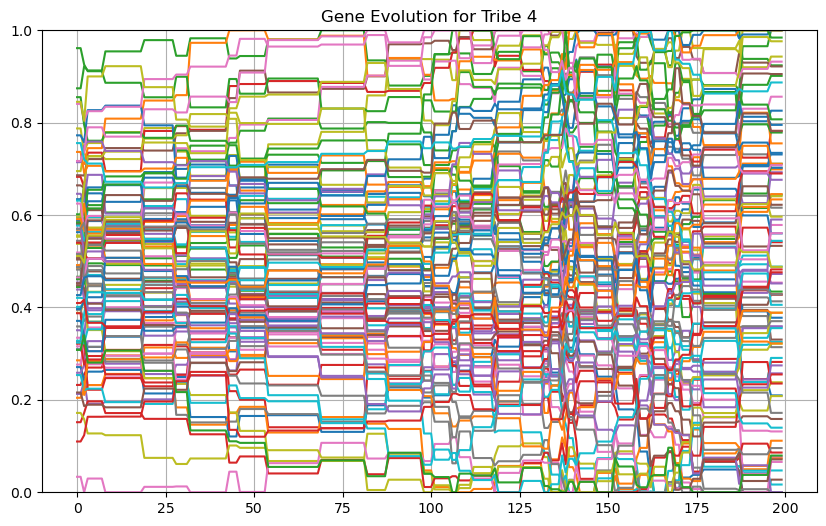

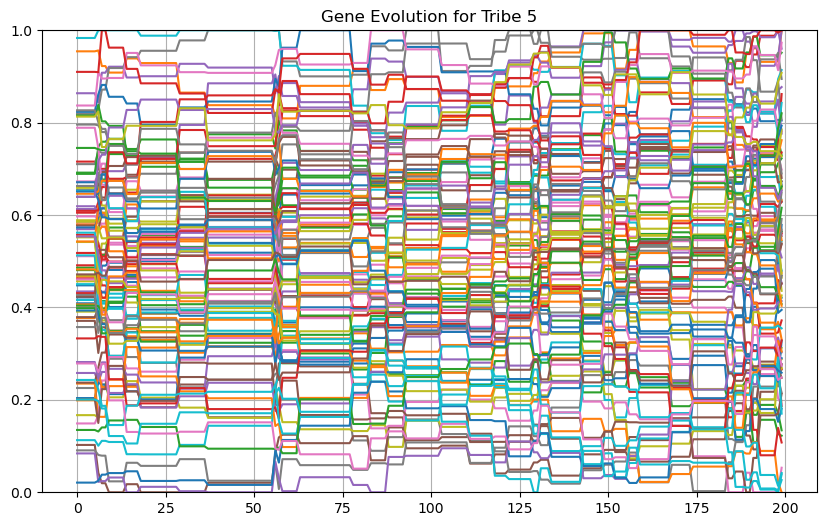

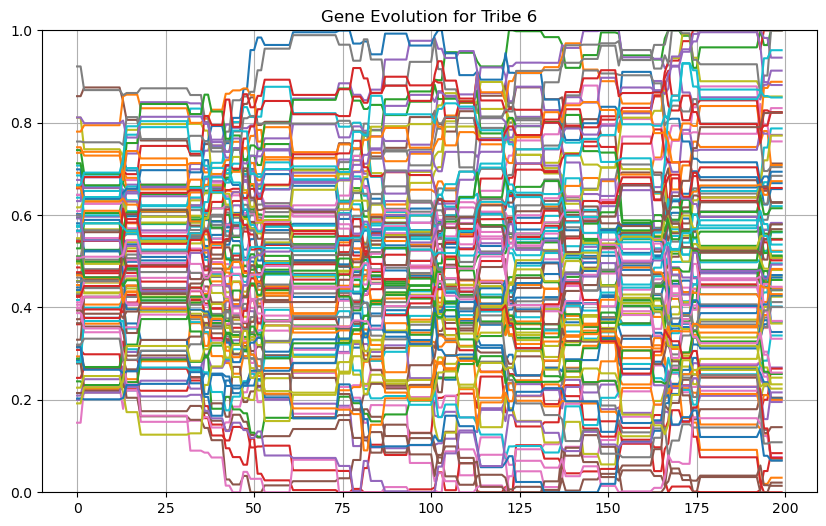

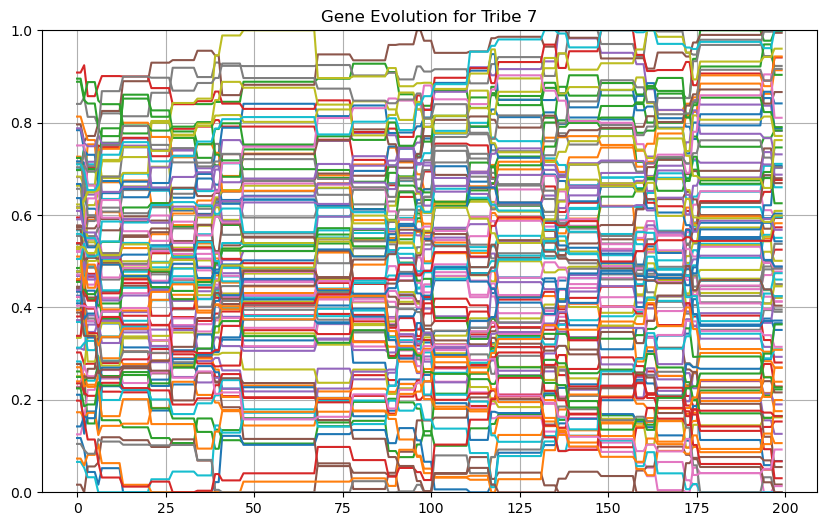

In [12]:
data200, instance200 = collect_and_visualize("../problems/p3.json", local_step_size=0.03, sigma=0.04)

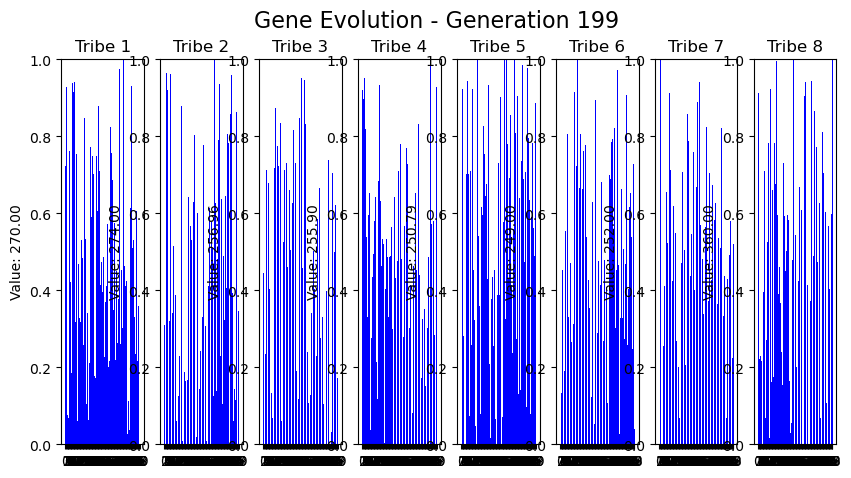

In [13]:
gene_displayer.visualize(data200)

In [14]:
solutions = correct_solutions(instance200)

In [15]:
best_solution_200, best_solutions_value_200 = max(solutions, key=lambda x: x[1])
print(f"Best solution [{best_solutions_value_200}]:\n{best_solution_200}")

Best solution [80]:
[8, 14, 17, 18, 22, 30, 31, 35, 44, 45, 52, 61, 62, 71, 72, 88, 89, 93]
